In [1]:
import matplotlib.pyplot as plt
import os
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly import subplots
from plotly.subplots import make_subplots

from sklearn import preprocessing
from scipy import stats
from scipy.stats import t

In [2]:
nlx_df = pd.read_csv('body/nlx/wmd_nlx_all_indicators_woclue.csv')

In [3]:
test = pd.read_csv('nlx-data-arguments/data-nlx-group.csv')


In [4]:
test['label'].value_counts()

nao_argumento    12994
argumento        10103
Name: label, dtype: int64

In [5]:
not_arg_df = nlx_df[nlx_df['label'] == 'nao_argumento']
arg_df = nlx_df[nlx_df['label'] != 'nao_argumento']

In [6]:
f = px.box(nlx_df, y='wmd_rate', color='label', color_discrete_sequence=['indianred', 'forestgreen'], height=650)
f.update_yaxes(
    dtick=0.009
)
# title="Nota do WMD por tipos de sentenças"
f.show()

In [7]:
# Medianas
print(0.7622895 - 0.7550861)

0.007203399999999971


### boxplot sem utilizar unigramas nos indicadores

In [8]:
wmd_u0 = pd.read_csv('body/nlx/without_unigrams/wmd_u0_nlx_all_indicators.csv')

In [9]:
u0_not_arg_df = wmd_u0[wmd_u0['label'] == 'nao_argumento']
u0_arg_df = wmd_u0[wmd_u0['label'] != 'nao_argumento']

In [10]:
fig = go.Figure()
# o x vai ser a fonte
# o y vai ser todos os wmds (u0 e u1)
x_arg=['sem_unigrama']*u0_arg_df.shape[0] + ['com_unigrama']*arg_df.shape[0]
x_not_arg=['sem_unigrama']*u0_not_arg_df.shape[0] + ['com_unigrama']*not_arg_df.shape[0]
fig.add_trace(go.Box(
    y=pd.concat([u0_not_arg_df['wmd_rate'], not_arg_df['wmd_rate']]),
    x=x_not_arg,
    name="Não argumento",
    marker_color='indianred'
))
fig.add_trace(go.Box(
    y=pd.concat([u0_arg_df['wmd_rate'], arg_df['wmd_rate']]),
    x=x_arg,
    name="Argumento",
    marker_color='forestgreen'

)) 
fig.update_layout(
    boxmode='group',
    title="WMD em comparação com indicadores com unigramas e sem unigramas",
    height=650,
    yaxis=dict(dtick=0.009, title="Nota do WMD")

)
fig.show()

In [11]:
mediana_arg0_unigram1 = 0.7622895
mediana_arg1_unigram1 = 0.7550861

mediana_arg0_unigram0 = 0.7918362
mediana_arg1_unigram0 = 0.7854566
print("diferença das medianas\nCom unigramas:", mediana_arg0_unigram1 - mediana_arg1_unigram1)
print("Sem unigramas:", mediana_arg0_unigram0-mediana_arg1_unigram0)
# Com unigramas a diferença é maior, ou seja, é melhor.

diferença das medianas
Com unigramas: 0.007203399999999971
Sem unigramas: 0.006379600000000041


# Histograma de quantidade de palavras
Tamanho das sentenças: quantidade de palavras

In [12]:

nlx_group_df = pd.read_csv('nlx-data-arguments/data-nlx-group.csv')
nlx_group_df['len_text'] = nlx_group_df['text'].apply(lambda x: len(x.split()))

In [13]:
print("Quantidade de sentenças cujo número de palavras é maior ou igual a 80:\n", nlx_group_df[nlx_group_df['len_text'] >= 80].shape[0])

print("Quantidade de sentenças cujo número de palavras é menor que 80:\n", nlx_group_df[nlx_group_df['len_text'] < 80].shape[0])

Quantidade de sentenças cujo número de palavras é maior ou igual a 80:
 99
Quantidade de sentenças cujo número de palavras é menor que 80:
 22998


In [14]:
fig = px.histogram(nlx_group_df, x='len_text', color="label", labels={"len_text": "quantidade de palavras"}, color_discrete_sequence=["red", "limegreen"],  barmode='group', title="Comparativo entre textos do nlx-group")

fig.update_xaxes(
    showgrid=True,
    # dtick = 10
)
fig.show()

Irei remover todas as sentenças acima de 80 palavras, pois atrapalha na visualização do histograma. Tem algumas sentenças de 600 palavras, outras de 200. Somando todas as sentenças acima de 80 palavras dá apenas 99 sentenças.

In [15]:
reduced_nlx_group_df = nlx_group_df[nlx_group_df['len_text'] < 80]

In [16]:
fig = px.histogram(reduced_nlx_group_df, x='len_text', color="label", labels={"len_text": "quantidade de palavras"}, color_discrete_sequence=["red", "limegreen"], nbins=25,  barmode='group', title="Comparativo entre textos do nlx-group marcados como argumento e não argumento")

fig.update_xaxes(
    showgrid=True,
    dtick = 5
)
fig.show()

In [17]:
f = px.box(nlx_group_df, y='len_text', log_y=True, height=550, points="all")
f.update_coloraxes()
f.update_yaxes(
    title='palavras por sentença'
)
f.show()

# f.write_image('plots/boxplots-wordbysentence-nlx.eps')

## Boxplot com cada uma das fontes

In [18]:
source_names = [
    'brasil_escola',
    # 'clue_words_pt',
    'acrobata_das_letras',
    'mundo_educacao',
    'Subjetivity_lexicon',
    'PersuativeEssays_UKP',
    '2020_Jonathan'
]

alias={
    'brasil_escola': 'Brasil Escola',
    'acrobata_das_letras': 'Acrobata das Letras',
    'mundo_educacao': 'Mundo Educação',
    'Subjetivity_lexicon': '(Jeronimo et al., 2019)',
    'PersuativeEssays_UKP': '(Stab \& Gurevych, 2017)',
    '2020_Jonathan': '(Nau, 2020)'
}

sources = list()
medians = dict()
for name in source_names:
    df = pd.read_csv(f'body/nlx/wmd_nlx_{name}.csv')
    name = alias[name]
    df['source'] = name
    sources.append(df)
    not_arg_rates = df[df['label'] == 'nao_argumento']['wmd_rate']
    arg_rates = df[df['label'] != 'nao_argumento']['wmd_rate']
    medians[name] = (np.median(not_arg_rates), np.median(arg_rates))

nlx_df['source'] = "Todos"
sources.append(nlx_df)
medians['Todos'] = (np.median(not_arg_df['wmd_rate']), np.median(arg_df['wmd_rate']))
df = pd.concat(sources)

In [19]:
not_arg_source_df = df[df['label'] == 'nao_argumento']
arg_source_df = df[df['label'] != 'nao_argumento']

In [20]:
df['label'].value_counts()

nao_argumento    87646
argumento        70148
Name: label, dtype: int64

In [21]:
fig = go.Figure()

fig.add_trace(go.Box(
    y=not_arg_source_df['wmd_rate'],
    x=not_arg_source_df['source'],
    name="Não argumento",
    marker_color='indianred'
))
fig.add_trace(go.Box(
    y=arg_source_df['wmd_rate'],
    x=arg_source_df['source'],
    name="Argumento",
    marker_color='forestgreen'

)) 
fig.update_layout(
    boxmode='group',
    # title="WMD em comparação com as fontes de indicadores",
    height=650,
    # width=900,
    yaxis=dict(dtick=0.009, title="Nota do WMD")

)

In [22]:
medians_diff = {k: abs(v[0] - v[1]) for (k, v) in medians.items()}

x = list(medians_diff.keys())
y = list(medians_diff.values())
fig = go.Figure(data=go.Bar(
    y=y,
    x=x,
    text=[f'{yi:.6f}' for yi in y],
    textposition='auto'
))

fig.update_layout(
    # title="Diferença das medianas das notas de wmd por cada fonte",
    xaxis={
        'categoryorder':'array',
        'categoryarray': [xi for _,xi in sorted(zip(y, x))]
        },
    yaxis={'title': 'wmd_rate median'}
)
fig.show()

## Analisando estatisticamente

In [23]:
def fdp(normal_dist):
    df = 2.74

    fig, ax = plt.subplots(1, 1)
    ax.plot(normal_dist, t.pdf(normal_dist, df), 'r<', lw=5, alpha=0.9, label='t pdf')

    rv = t(df)

    ax.plot(normal_dist, rv.pdf(normal_dist), 'y>', lw=1, label='frozen pdf')
    ax.legend(loc='best', frameon=False)

    vals = t.ppf([0.001, 0.5, 0.999], df)
    if (np.allclose([0.001, 0.5, 0.999], t.cdf(vals, df))):
        return plt.show()
    else:
        return "False"
def plot_two_histograms(dist1, dist2):
    fig = make_subplots(rows=2, cols=1)
    fig.add_trace(
        go.Histogram(x=dist1['dist'], name=dist1['name']),
        row=1, col=1
    )
    fig.add_trace(
        go.Histogram(x=dist2['dist'], name=dist2['name']),
        row=2, col=1
    )
    fig.update_layout(height=800)
    return fig.show()
def normal_transform(wmd_dist):
    pt = preprocessing.PowerTransformer()
    data = np.array(wmd_dist).reshape(-1, 1)
    transformed_data = pt.fit_transform(data)
    return transformed_data.reshape(-1)

In [24]:
def statistic_analysis(wmd_dist1, wmd_dist2):
    plot_two_histograms(wmd_dist1, wmd_dist2)
    transformed_dist1 = {'dist': normal_transform(wmd_dist1['dist']), 'name': 'normal_' + wmd_dist1['name']}
    transformed_dist2 = {'dist': normal_transform(wmd_dist2['dist']), 'name': 'normal_' + wmd_dist2['name']}
    print('Normal histogram: ')
    plot_two_histograms(transformed_dist1, transformed_dist2)
    print('FDP ', transformed_dist1['name'])
    fdp(transformed_dist1['dist'])
    print('FDP ', transformed_dist2['name'])
    fdp(transformed_dist2['dist'])
    
    print('-'*20)
    print('Distribution')
    print('-'*20)
    print(wmd_dist1['name'] + ':')
    print(stats.normaltest(wmd_dist1['dist']))
    print(wmd_dist2['name'] + ':')
    print(stats.normaltest(wmd_dist2['dist']))
    print('-'*20)
    print('Normal Distribution')
    print('-'*20)
    print(transformed_dist1['name'] + ':')
    print(stats.normaltest(transformed_dist1['dist']))
    print(transformed_dist2['name'] + ':')
    print(stats.normaltest(transformed_dist2['dist']))
    print('-'*20 + '\n')
    

    print(f"T test entre {wmd_dist1['name']} e {wmd_dist2['name']}")
    print(stats.ttest_ind(wmd_dist1['dist'], wmd_dist2['dist']))
    print('-'*20)
    print(f"T test entre {transformed_dist1['name']} e {transformed_dist2['name']}")
    print(stats.ttest_ind(transformed_dist1['dist'], transformed_dist2['dist']))


Normal histogram: 


FDP  normal_not_arg


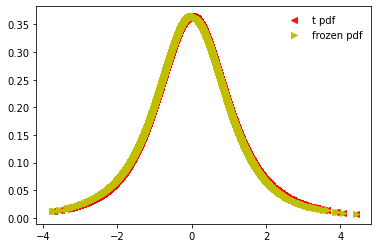

FDP  normal_arg


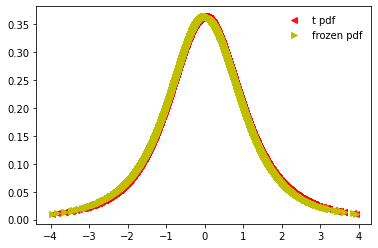

--------------------
Distribution
--------------------
not_arg:
NormaltestResult(statistic=116.00927509764159, pvalue=6.440298365079775e-26)
arg:
NormaltestResult(statistic=119.5427938695469, pvalue=1.1005559740500751e-26)
--------------------
Normal Distribution
--------------------
normal_not_arg:
NormaltestResult(statistic=28.40494106091276, pvalue=6.791182777948278e-07)
normal_arg:
NormaltestResult(statistic=14.44111776909645, pvalue=0.0007313935400848697)
--------------------

T test entre not_arg e arg
Ttest_indResult(statistic=24.046947410248873, pvalue=3.5020591102655234e-126)
--------------------
T test entre normal_not_arg e normal_arg
Ttest_indResult(statistic=-2.959520685009036e-13, pvalue=0.9999999999997639)


In [25]:
statistic_analysis({'dist': not_arg_df['wmd_rate'], 'name': 'not_arg'}, {'dist': arg_df['wmd_rate'], 'name': 'arg'})

T test

In [31]:
pvalue_index = list(alias.values()) + ['Todos']
pvalue_df = pd.DataFrame(index=pvalue_index, columns=['arg/notarg'])

In [32]:
# unified database
for source in alias.values():
    pvalue_df['arg/notarg'][source] = stats.ttest_ind(
        arg_source_df[arg_source_df['source'] == source]['wmd_rate'],
        not_arg_source_df[not_arg_source_df['source'] == source]['wmd_rate']
    ).pvalue

pvalue_df['arg/notarg']['Todos'] = stats.ttest_ind(
    arg_df['wmd_rate'], not_arg_df['wmd_rate']
).pvalue

In [33]:
pvalue_df

,arg/notarg
Brasil Escola,1.30918e-71
Acrobata das Letras,7.12453e-119
Mundo Educação,1.10611e-87
"(Jeronimo et al., 2019)",6.39107e-109
"(Stab \& Gurevych, 2017)",3.31811e-44
"(Nau, 2020)",1.21113e-32
Todos,3.50206e-126
